In [1]:


################################ GLOBAL VARIABLES ############################
import os
CURR_PATH=os.getcwd()

########## DATA ##########
MODANET_ANNO = CURR_PATH + "/modanet/annotations/modanet2018_instances_train.json"
MODANET_VAL =  CURR_PATH + "/modanet/annotations/modanet2018_instances_val.json"

PAPERDOLL_META_DB =  CURR_PATH + "/data/paperdoll/chictopia.sqlite3"
PAPERDOLL_IMG_DB =  CURR_PATH + "/data/paperdoll/photos.lmdb"
PAPERDOLL_IMG_SITE = "http://images2.chictopia.com"


MODANET_ANNO = "./modanet/annotations/modanet2018_instances_train.json"
MODANET_VAL =  "./modanet/annotations/modanet2018_instances_val.json"
PAPERDOLL_META_DB =  "./data/paperdoll/chictopia.sqlite3"
PAPERDOLL_IMG_DB =  "./data/paperdoll/photos.lmdb"

## pretrain data
PRETRAIN_WEIGHT_FILE =  os.path.join(CURR_PATH, "weight_files/logs/modanet20190718T1840/mask_rcnn_modanet_0007.h5")
LOG_DIR =  os.path.join(CURR_PATH, "weight_files/logs")

########## MODEL ##########
JOB_NAME = "MODANET"
MODEL_TYPE = 'resnet50'
NUM_CATS = 13
IMAGE_SIZE = 512 #INPUT IMAGE SIZE : IMAGE_SIZE * IMAGE_SIZE

GPU_NUM = 1 #1# 2# 4# #8
IMAGES_PER_GPU_PER_IT = 4 #4 


STEPS_PER_EPOCH_NUM = 500 #40000
VALIDATION_STEPS_NUM = 100


LR = 1e-4
#EPOCHS = [2, 4, 8, 16, 32, 64]
EPOCHS = [2, 4, 8, 9, 10, 11]

N_FOLDS = 5
SELECT_FOLD_IDX = 3


## pretrain data
FGVC6_WEIGHT_FIEL =  CURR_PATH + "/weight_files/mask_rcnn_FGVC6_0008.h5" 
LOG_DIR =  CURR_PATH + "/weight_files/logs"

PRETRAIN_WEIGHT_FILE =  os.path.join(CURR_PATH, "weight_files/logs/modanet20190718T1840/mask_rcnn_modanet_0007.h5")
LOG_DIR =  os.path.join(CURR_PATH, "weight_files/logs")

###########################################################################
    


# Train Model

In [2]:
import os
import io
import sys
import json
import datetime
import numpy as np
import skimage.draw

from pycocotools.coco import COCO
import skimage.io as imio
import matplotlib.pyplot as plt
import cv2
import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
import itertools
from tqdm import tqdm

from imgaug import augmenters as iaa
from sklearn.model_selection import StratifiedKFold, KFold
import pylab
#from pathlib import Path

import lmdb
import sqlite3
import pandas as pd
from PIL import Image
from IPython.display import display


 
# Import Mask RCNN
sys.path.append("./mask_rcnn_lib")  # To find local version of the library
from mrcnn.config import Config
from mrcnn import model as modellib, utils
from pycocotools import mask as maskUtils
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log
from tensorflow.contrib.tensorboard.plugins import projector


############################################################
#  Configurations
############################################################
#Photo data in LMDB

class PhotoData(object):
    def __init__(self, path):
        self.env = lmdb.open(
            path, map_size=2**36, readonly=True, lock=False
        )
        
    def __iter__(self):
        with self.env.begin() as t:
            with t.cursor() as c:
                for key, value in c:
                    yield key, value
        
    def __getitem__(self, index):
        key = str(index).encode('ascii')
        with self.env.begin() as t:
            data = t.get(key) # binary image data
        if not data:
            return None
        
        with io.BytesIO(data) as f:
                image = Image.open(f)
                try:
                    image = image.convert("RGB")
                    image.load()
                except:
                    pass
                
                if None == image:
                    try:
                        print(image.format)
                        image = image.convert("L")
                        image.load()
                    except:
                        pass
                    
        return np.array(image)
    
        
    def __len__(self):
        return self.env.stat()['entries']
    
    def get_all_keys(self, mod=1000):
        lst = []
        txn = self.env.begin()
        for key, value in txn.cursor():
            #k = bytes.decode(key)
            k = str(key, encoding = "utf-8")
            lst.append(k)
            if  mod > 0 and len(lst) % mod == 0 :
                print(len(lst), " last key : ", k)
                
        return lst

class ModaNetConfig(Config):
    def __init__(self, class_num=NUM_CATS, config_name=JOB_NAME):
        self.NUM_CLASSES = class_num + 1 # +1 for the background class
        self.NAME = config_name
        super().__init__()
      
    BACKBONE = MODEL_TYPE
"""     
    GPU_COUNT = GPU_NUM
    IMAGES_PER_GPU = IMAGES_PER_GPU_PER_IT 

    
    IMAGE_MIN_DIM = IMAGE_SIZE
    IMAGE_MAX_DIM = IMAGE_SIZE    

    RPN_ANCHOR_SCALES = (16, 32, 64, 128, 256)
    
    STEPS_PER_EPOCH = STEPS_PER_EPOCH_NUM

    # Skip detections with < 90% confidence
    #DETECTION_MIN_CONFIDENCE = 0.9
"""    


############################################################
#  Dataset
############################################################

class ModaNetDataset(utils.Dataset):
    def __init__(self, photo_meta_db, coco, label_names, cat_ids):
        
        super().__init__(self)
        self.coco = coco
        self.label_names = label_names
        self.catIds = cat_ids
        self.photo_meta_db = photo_meta_db
        self.imgid2idx = {}
        self.count = 0
        
    def load_all_dataset(self):
        # Add classes
        for i, name in enumerate(self.label_names):
            self.add_class("fashion", i+1, name)
            
        # Add images and annotations
        for i, row in self.photo_meta_db.iterrows():
            
            annIds = self.coco.getAnnIds(imgIds=row['id'], catIds=self.catIds, iscrowd=None)
            anns = self.coco.loadAnns(annIds)
            catids, polygons = [], []
            for one in anns:
                catids.append(one['category_id'])
                polygons.extend(one['segmentation'])
                

            
            if len(polygons) == 0:
                continue
            
            fp = row['path'].split("?")[0]
            if False == fp.lower().endswith("jpg") and False == fp.lower().endswith("jpeg"):
                continue
                
            self.add_image("fashion", 
                           image_id = self.count,  #============> ID
                           path = CURR_PATH + "/data/paperdoll/images" + fp ,
                           labels = catids,
                           polygons = polygons,
                           height = row['height'], width=row['width'],
                           annotations = self.coco.loadAnns(self.coco.getAnnIds(
                            imgIds=row['id'], catIds=self.catIds, iscrowd=None)))

        
        print("load all data done, type :", self.class_info)
    
    def annToRLE(self, ann, height, width):
        """
        Convert annotation which can be polygons, uncompressed RLE to RLE.
        :return: binary mask (numpy 2D array)
        """
        segm = ann['segmentation']
        if isinstance(segm, list):
            # polygon -- a single object might consist of multiple parts
            # we merge all parts into one mask rle code
            rles = maskUtils.frPyObjects(segm, height, width)
            rle = maskUtils.merge(rles)
        elif isinstance(segm['counts'], list):
            # uncompressed RLE
            rle = maskUtils.frPyObjects(segm, height, width)
        else:
            # rle
            rle = ann['segmentation']
        return rle
    
    def annToMask(self, ann, height, width):
        """
        Convert annotation which can be polygons, uncompressed RLE, or RLE to binary mask.
        :return: binary mask (numpy 2D array)
        """
        rle = self.annToRLE(ann, height, width)
        m = maskUtils.decode(rle)
        return m
    
    def load_mask(self, image_id):
        """Load instance masks for the given image.

        Different datasets use different ways to store masks. This
        function converts the different mask format to one format
        in the form of a bitmap [height, width, instances].

        Returns:
        masks: A bool array of shape [height, width, instance count] with
            one mask per instance.
        class_ids: a 1D array of class IDs of the instance masks.
        """
        # If not a COCO image, delegate to parent class.
        image_info = self.image_info[image_id]
        
        instance_masks = []
        class_ids = []
        annotations = self.image_info[image_id]["annotations"]
        # Build mask of shape [height, width, instance_count] and list
        # of class IDs that correspond to each channel of the mask.
        for annotation in annotations:
            class_id = self.map_source_class_id(
                "fashion.{}".format(annotation['category_id']))
            if class_id:
                m = self.annToMask(annotation, image_info["height"],
                                   image_info["width"])
                # Some objects are so small that they're less than 1 pixel area
                # and end up rounded out. Skip those objects.
                if m.max() < 1:
                    continue
                # Is it a crowd? If so, use a negative class ID.
                if annotation['iscrowd']:
                    # Use negative class ID for crowds
                    class_id *= -1
                    # For crowd masks, annToMask() sometimes returns a mask
                    # smaller than the given dimensions. If so, resize it.
                    if m.shape[0] != image_info["height"] or m.shape[1] != image_info["width"]:
                        m = np.ones([image_info["height"], image_info["width"]], dtype=bool)
                instance_masks.append(m)
                class_ids.append(class_id)

        # Pack instance masks into an array
        if class_ids:
            mask = np.stack(instance_masks, axis=2).astype(np.bool)
            class_ids = np.array(class_ids, dtype=np.int32)
            return mask, class_ids
        else:
            # Call super class to return an empty mask
            return super(ModaNetDataset, self).load_mask(image_id)

           
    
    def image_reference(self, image_id):
        """Return the path of the image."""
        #info = self.image_info[image_id]
        #return  [label_names[int(x)-1] for x in info['labels']]
        #return super(ModaNetDataset, self).image_reference(image_id)
        return super(self.__class__, self).image_reference(image_id)
"""    
    def load_mask(self, image_id):
        #return super(self.__class__, self).load_mask(image_id)  
        # Convert polygons to a bitmap mask of shape
        # [height, width, instance_count]
        
        info = self.image_info[image_id]
        if len(info["polygons"]) != len(info['labels']):
            print("######## MISMATCH DATA##########")
           
           
           
           
           
        mask = np.zeros([info["height"], info["width"], len(info["polygons"])],dtype=np.uint8)
        labels = []
        for i, (p, label)  in enumerate(zip(info["polygons"], info['labels'])):
            all_points_x = []
            all_points_y = []
            idx = 0
            while idx < len(p):                
                all_points_x.append(p[idx])
                all_points_y.append(p[idx+1])
                idx += 2
            # Get indexes of pixels inside the polygon and set them to 1
            rr, cc = skimage.draw.polygon(all_points_y, all_points_x)
            mask[rr, cc, i] = 1
            labels.append(int(label)+1)

        # Return mask, and array of class IDs of each instance. Since we have
        # one class ID only, we return an array of 1s
        return mask.astype(np.bool), np.array(labels) 
    
    
    
    
    
        info = self.image_info[image_id]
        mask = np.zeros((IMAGE_SIZE, IMAGE_SIZE, len(info["polygons"])), dtype=np.uint8)
        labels = []
        
        for m, (annotation, label) in enumerate(zip(info["polygons"], info['labels'])):
            sub_mask = np.full(info['height']*info['width'], 0, dtype=np.uint8)
            all_points_x = []
            all_points_y = []
            idx = 0
            while idx < len(annotation):                
                all_points_x.append(annotation[idx])
                all_points_y.append(annotation[idx+1])
                idx += 2
                
            rr, cc = skimage.draw.polygon(all_points_y, all_points_x)
            sub_mask[rr, cc, m] = 1 ##??
            
            sub_mask = cv2.resize(sub_mask, (IMAGE_SIZE, IMAGE_SIZE), interpolation=cv2.INTER_NEAREST)
            mask[:, :, m] = sub_mask
            labels.append(int(label)+1)
            
        if len(info["polygons"]) != len(info['labels']):
            print("######## MISMATCH DATA##########")
            
        return mask, np.array(labels)
"""  
    

Using TensorFlow backend.


'    \n    def load_mask(self, image_id):\n        #return super(self.__class__, self).load_mask(image_id)  \n        # Convert polygons to a bitmap mask of shape\n        # [height, width, instance_count]\n        \n        info = self.image_info[image_id]\n        if len(info["polygons"]) != len(info[\'labels\']):\n            print("######## MISMATCH DATA##########")\n           \n           \n           \n           \n           \n        mask = np.zeros([info["height"], info["width"], len(info["polygons"])],dtype=np.uint8)\n        labels = []\n        for i, (p, label)  in enumerate(zip(info["polygons"], info[\'labels\'])):\n            all_points_x = []\n            all_points_y = []\n            idx = 0\n            while idx < len(p):                \n                all_points_x.append(p[idx])\n                all_points_y.append(p[idx+1])\n                idx += 2\n            # Get indexes of pixels inside the polygon and set them to 1\n            rr, cc = skimage.draw.pol

In [3]:
####### Model Config

config = ModaNetConfig()
config.display()


Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     2
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 2
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                26
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE          

In [4]:

####### Photo Meta Data

access_str = "file:" + PAPERDOLL_META_DB + "?mode=ro"
meta_db = sqlite3.connect(access_str, uri=True)
photo_meta_db = pd.read_sql("""
            SELECT
                *
            FROM photos
            WHERE photos.post_id IS NOT NULL AND file_file_size IS NOT NULL
        """, con=meta_db)

####### Image DataSet

photo_data_set = PhotoData(PAPERDOLL_IMG_DB)


####### Annotation Data
coco = COCO(MODANET_ANNO)



loading annotations into memory...
Done (t=4.72s)
creating index...
index created!


In [5]:
config = ModaNetConfig()
config.display()


Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     2
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 2
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                26
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE          

In [6]:
print(coco.getCatIds())
#id_set = coco.getImgIds(catIds=coco.getCatIds())
cats = coco.loadCats(coco.getCatIds())
print(cats)
label_names = [cat['name'] for cat in cats]
print(label_names)
cat_ids = coco.getCatIds(catNms = label_names)
print(cat_ids)

anno_img_id_set = []
for i in range(len(cat_ids)):
    anno_img_id_set.extend(coco.getImgIds(catIds=[i]))
print("total annotation number: ", len(anno_img_id_set))


[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
[{'supercategory': 'fashion', 'id': 1, 'name': 'bag'}, {'supercategory': 'fashion', 'id': 2, 'name': 'belt'}, {'supercategory': 'fashion', 'id': 3, 'name': 'boots'}, {'supercategory': 'fashion', 'id': 4, 'name': 'footwear'}, {'supercategory': 'fashion', 'id': 5, 'name': 'outer'}, {'supercategory': 'fashion', 'id': 6, 'name': 'dress'}, {'supercategory': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'supercategory': 'fashion', 'id': 8, 'name': 'pants'}, {'supercategory': 'fashion', 'id': 9, 'name': 'top'}, {'supercategory': 'fashion', 'id': 10, 'name': 'shorts'}, {'supercategory': 'fashion', 'id': 11, 'name': 'skirt'}, {'supercategory': 'fashion', 'id': 12, 'name': 'headwear'}, {'supercategory': 'fashion', 'id': 13, 'name': 'scarf/tie'}]
['bag', 'belt', 'boots', 'footwear', 'outer', 'dress', 'sunglasses', 'pants', 'top', 'shorts', 'skirt', 'headwear', 'scarf/tie']
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
total annotation number:  211828


In [7]:
# drop  images meta entries that without annotation
anno_img_id_pd = pd.DataFrame({'id':anno_img_id_set})
anno_img_id_pd['id'] =anno_img_id_pd['id'].apply(int)
photo_meta_db = pd.merge(photo_meta_db, anno_img_id_pd, how='inner', on=['id'])
# drop duplicate
photo_meta_db = photo_meta_db.drop_duplicates()
print("photo_meta_db size: ", len(photo_meta_db))

photo_meta_db size:  52254


In [8]:
print(photo_meta_db.head())

     id  post_id                                               path  status  \
0     3       73  /photos/thefashbot/3613535083/3420751783/34207...       2   
4    13      142   /photos/thefashbot/2353856772/2353856772_400.jpg       2   
10  148       79     /photos/poppylee/3083327112/3083327112_400.jpg       2   
14  156      104     /photos/poppylee/8150270690/8150270690_400.jpg       2   
17  174      353     /photos/Carolina/7809452194/7809452194_400.jpg       2   

                    file_file_name  file_file_size file_content_type  \
0   open-uri20120907-29328-1uz77bi          115073        image/jpeg   
4     open-uri20120907-29328-s7gmu          106894        image/jpeg   
10  open-uri20120907-29328-1l7sf9u          124987        image/jpeg   
14   open-uri20120907-29328-v7lh6v          126139        image/jpeg   
17  open-uri20120907-29328-1x0oi3x          208504        image/jpeg   

               file_updated_at  width  height                  created_at  \
0   2012-09-07 

In [9]:
photo_meta_db = photo_meta_db.drop_duplicates()


In [10]:
dataset = ModaNetDataset(photo_meta_db, coco, label_names, cat_ids)
dataset.load_all_dataset()
dataset.prepare()

load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id': 11, 'name': 'skirt'}, {'source': 'fashion', 'id': 12, 'name': 'headwear'}, {'source': 'fashion', 'id': 13, 'name': 'scarf/tie'}]



(600, 400, 5) [8 1 4 4 5] 5 5 8
{'id': 0, 'source': 'fashion', 'path': '/root/workspace/product_image_segmentation/data/paperdoll/images/photos/luckapucka/7004443104/black-topshop-boots-tan-asos-coat-carrot-orange-calzedonia-tights_400.jpg', 'labels': [8, 1, 4, 4, 5], 'polygons': [[141, 512, 141, 488, 141, 470, 142, 446, 147, 427, 152, 413, 153, 405, 149, 395, 149, 382, 150, 376, 160, 367, 173, 365, 180, 368, 187, 371, 189, 375, 192, 379, 193, 381, 201, 371, 207, 369, 213, 368, 219, 368, 223, 369, 232, 375, 237, 385, 235, 398, 228, 410, 224, 409, 223, 418, 219, 436, 216, 451, 212, 463, 202, 483, 200, 488, 195, 499, 189, 514, 173, 512, 169, 511, 172, 501, 175, 479, 176, 461, 180, 446, 186, 429, 190, 415, 192, 397, 183, 420, 179, 438, 178, 445, 175, 462, 169, 480, 162, 509, 163, 512, 161, 513, 159, 520, 145, 521, 140, 518], [134, 279, 139, 269, 144, 254, 148, 235, 150, 222, 156, 198, 166, 201, 160, 219, 153, 242, 151, 254, 150, 266, 147, 274, 145, 280, 141, 286, 136, 286, 134, 283], [10

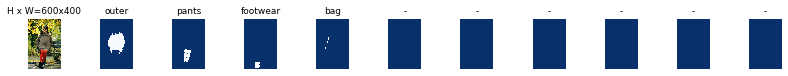


(600, 400, 6) [8 9 4 4 5 1] 6 6 11
{'id': 0, 'source': 'fashion', 'path': '/root/workspace/product_image_segmentation/data/paperdoll/images/photos/lioncave/4920227197/4920227197_400.jpg', 'labels': [8, 9, 4, 4, 5, 1], 'polygons': [[161, 265, 183, 268, 216, 270, 233, 267, 221, 299, 212, 315, 208, 339, 215, 350, 231, 345, 240, 340, 244, 327, 242, 362, 237, 407, 240, 435, 243, 461, 244, 491, 243, 504, 243, 512, 236, 517, 218, 518, 205, 514, 204, 493, 197, 494, 182, 493, 179, 491, 171, 428, 168, 384, 164, 369, 157, 339, 154, 291, 157, 269], [179, 136, 173, 172, 173, 194, 170, 210, 167, 228, 160, 250, 158, 256, 161, 265, 182, 268, 216, 270, 233, 267, 236, 260, 217, 262, 194, 262, 188, 252, 184, 224, 182, 172, 182, 157, 187, 144], [234, 541, 226, 556, 218, 567, 213, 575, 200, 582, 187, 581, 187, 577, 188, 572, 186, 569, 177, 572, 167, 577, 166, 583, 170, 587, 177, 590, 188, 592, 197, 592, 205, 591, 216, 578, 224, 571, 230, 568, 232, 584, 236, 586, 240, 564, 243, 551, 240, 543, 237, 540], [2

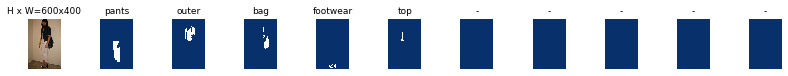


(600, 400, 6) [5 2 6 8 4 4] 6 6 8
{'id': 0, 'source': 'fashion', 'path': '/root/workspace/product_image_segmentation/data/paperdoll/images/photos/alexandrafritz/11145457146/white-isaac-mizrahi-cardigan-red-vintage-hand-me-down-dress-black-peace-sign_400.jpg', 'labels': [5, 2, 6, 8, 4, 4], 'polygons': [[186, 137, 188, 161, 178, 188, 177, 229, 181, 271, 175, 274, 164, 267, 154, 262, 159, 245, 159, 233, 166, 223, 165, 206, 159, 202, 151, 179, 146, 157, 152, 144, 164, 137, 172, 144, 179, 140], [275, 185, 273, 213, 275, 246, 274, 254, 267, 263, 265, 268, 256, 266, 243, 266, 247, 246, 244, 212, 241, 189, 234, 166, 225, 157, 231, 140, 229, 123, 243, 123, 254, 124, 274, 129, 293, 146, 314, 174, 324, 186, 311, 198, 299, 206, 292, 196, 281, 188], [182, 250, 207, 260, 222, 264, 235, 266, 244, 266, 246, 247, 239, 248, 231, 251, 211, 248, 184, 238, 176, 229, 179, 249], [184, 239, 211, 248, 231, 251, 239, 248, 246, 246, 244, 212, 241, 189, 234, 166, 225, 157, 231, 138, 230, 131, 222, 141, 211, 145,

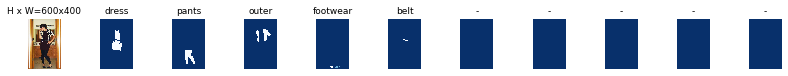

In [11]:
# CHECK THE DATABASE

for i in range(3):
    image_id = random.choice(dataset.image_ids)
    print(dataset.image_reference(image_id))
    
    image = dataset.load_image(image_id)
    mask, class_ids = dataset.load_mask(image_id)

    print(mask.shape, class_ids ,len(class_ids), len(dataset.image_info[image_id]['labels']),  len(dataset.image_info[image_id]['polygons']))
    print(dataset.image_info[image_id])
    visualize.display_top_masks(image, mask, class_ids, dataset.class_names, limit=10)

In [13]:
print("category distribution: ")
total_num = 0
for i in cat_ids:
    print(i, len(coco.getImgIds(catIds=[i])))
    total_num += len(coco.getImgIds(catIds=[i]))
    
print(total_num)

category distribution: 
1 20570
2 14295
3 7084
4 39222
5 23691
6 14426
7 8792
8 23015
9 34681
10 7031
11 13575
12 5446
13 5020
216848


In [12]:
import os
import io
import sys
import json
import datetime
import numpy as np
import skimage.draw

from pycocotools.coco import COCO
import skimage.io as imio
import matplotlib.pyplot as plt
import cv2
import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
import itertools
from tqdm import tqdm

from imgaug import augmenters as iaa
from sklearn.model_selection import StratifiedKFold, KFold
import pylab
#from pathlib import Path

import lmdb
import sqlite3
import pandas as pd
from PIL import Image
from IPython.display import display


 
# Import Mask RCNN
sys.path.append("./mask_rcnn_lib" )  # To find local version of the library
from mrcnn.config import Config
from mrcnn import model as modellib, utils


from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log
from tensorflow.contrib.tensorboard.plugins import projector

    

In [13]:
kf = KFold(n_splits=N_FOLDS, shuffle=True)
splits = kf.split(photo_meta_db) 

def get_fold(splits, train_df, idx):    
    for i, (train_index, valid_index) in enumerate(splits):
        if i == idx:
            return train_df.iloc[train_index], train_df.iloc[valid_index]
        
train_df, valid_df = get_fold(splits, photo_meta_db, SELECT_FOLD_IDX)

print("train set size: " , len(train_df))
print("valid set size: " , len(valid_df))

train_dataset = ModaNetDataset(train_df, coco, label_names, cat_ids)
train_dataset.load_all_dataset()
train_dataset.prepare()


valid_dataset = ModaNetDataset(valid_df, coco, label_names, cat_ids)
valid_dataset.load_all_dataset()
valid_dataset.prepare()


train set size:  41803
valid set size:  10451
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id': 11, 'name': 'skirt'}, {'source': 'fashion', 'id': 12, 'name': 'headwear'}, {'source': 'fashion', 'id': 13, 'name': 'scarf/tie'}]
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'i

In [15]:
model = modellib.MaskRCNN(mode="training", config=config, model_dir=LOG_DIR)   
model_path = "/root/workspace/product_image_segmentation/weight_files/logs/modanet20190718T1840/mask_rcnn_modanet_0016.h5"

# 40 hours file:
#model_path = "/root/workspace/product_image_segmentation/weight_files/logs/modanet20190718T1840/mask_rcnn_modanet_0001.h5"
#model_path = "/root/workspace/product_image_segmentation/weight_files/mask_rcnn_coco.h5"

model.load_weights(model_path, by_name=True, 
                   exclude=["mrcnn_class_logits", "mrcnn_bbox_fc","mrcnn_bbox", "mrcnn_mask"])




W0721 15:18:08.826472 140087849633600 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0721 15:18:08.833436 140087849633600 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0721 15:18:08.862289 140087849633600 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0721 15:18:08.892003 140087849633600 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:1919: The name tf.nn.fused_batch_norm is deprecated. Please use tf.compat.v1.nn.fused_batch_norm instead.

W0721 15:18:08.895516 140087849

Re-starting from epoch 16


In [28]:
model.train(train_dataset, valid_dataset,
            learning_rate=LR*30,
            epochs=2,
            layers='heads',
            augmentation=None)

#history = model.keras_model.history.history


Starting at epoch 1. LR=0.003

Checkpoint Path: /root/workspace/product_image_segmentation/weight_files/logs/modanet20190718T1840/mask_rcnn_modanet_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv

W0720 23:45:03.483469 139721404905280 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Co

Epoch 2/2
1000/1000 [==============================] - 2127s 2s/step - loss: 1.5566 - rpn_class_loss: 0.0319 - rpn_bbox_loss: 0.4259 - mrcnn_class_loss: 0.4791 - mrcnn_bbox_loss: 0.2815 - mrcnn_mask_loss: 0.3382 - val_loss: 2.1288 - val_rpn_class_loss: 0.0566 - val_rpn_bbox_loss: 0.7129 - val_mrcnn_class_loss: 0.6822 - val_mrcnn_bbox_loss: 0.3423 - val_mrcnn_mask_loss: 0.3349


In [16]:
import random

def get_fold(splits, train_df, idx):    
    for i, (train_index, valid_index) in enumerate(splits):
        if i == idx:
            return train_df.iloc[train_index], train_df.iloc[valid_index]
        

def split_dateset(photo_meta_db, N_FOLDS, coco, label_names, cat_ids):
    selected = random.randint(0,10000)%N_FOLDS

    kf = KFold(n_splits=N_FOLDS, shuffle=True)
    splits = kf.split(photo_meta_db) 
 
    train_set, valid_set = get_fold(splits, photo_meta_db, selected)


    train_dataset = ModaNetDataset(train_set, coco, label_names, cat_ids)
    train_dataset.load_all_dataset()
    train_dataset.prepare()
    print("train set size: " , len(train_set), type(train_dataset))

    valid_dataset = ModaNetDataset(valid_set, coco, label_names, cat_ids)
    valid_dataset.load_all_dataset()
    valid_dataset.prepare()
    print("valid set size: " , len(valid_set), type(valid_dataset))
    
    return train_dataset, valid_dataset



In [17]:
epo = 0
LRs = [20, 15, 5, 10, 3, 5, 0.7, 0.3, 13, 0.7, 11, 17, 0.7, 0.3, 20, 15, 5, 10, 15, 5, 10, 3, 5, 0.7, 0.3, 13, 0.7, 11, 17, 0.7, 0.3, 20, 15, 5, 10]
while epo < len(LRs):
    train_set, valid_set = split_dateset(photo_meta_db, N_FOLDS, coco, label_names, cat_ids)

    model.train(train_set, valid_set,
            learning_rate = LR * LRs[epo],
            epochs = epo + 17,
            layers = 'all',
            augmentation=None)
    print("One epoch done, NO.: {}  LR: {}".format(epo+17, LRs[epo]))
    epo = epo + 1
    

load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id': 11, 'name': 'skirt'}, {'source': 'fashion', 'id': 12, 'name': 'headwear'}, {'source': 'fashion', 'id': 13, 'name': 'scarf/tie'}]
train set size:  41803 <class '__main__.ModaNetDataset'>
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'f

W0721 15:18:52.048605 140087849633600 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Co

Epoch 17/17
1000/1000 [==============================] - 2815s 3s/step - loss: 1.3800 - rpn_class_loss: 0.0234 - rpn_bbox_loss: 0.3563 - mrcnn_class_loss: 0.3920 - mrcnn_bbox_loss: 0.2920 - mrcnn_mask_loss: 0.3163 - val_loss: 2.2888 - val_rpn_class_loss: 0.1250 - val_rpn_bbox_loss: 1.1127 - val_mrcnn_class_loss: 0.3877 - val_mrcnn_bbox_loss: 0.3394 - val_mrcnn_mask_loss: 0.3239
One epoch done, NO.: 17  LR: 20
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 18/18
1000/1000 [==============================] - 2746s 3s/step - loss: 1.1648 - rpn_class_loss: 0.0207 - rpn_bbox_loss: 0.3466 - mrcnn_class_loss: 0.3149 - mrcnn_bbox_loss: 0.2135 - mrcnn_mask_loss: 0.2692 - val_loss: 1.5129 - val_rpn_class_loss: 0.0363 - val_rpn_bbox_loss: 0.5646 - val_mrcnn_class_loss: 0.3650 - val_mrcnn_bbox_loss: 0.2464 - val_mrcnn_mask_loss: 0.3007
One epoch done, NO.: 18  LR: 15
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 19/19
1000/1000 [==============================] - 2731s 3s/step - loss: 1.2535 - rpn_class_loss: 0.0239 - rpn_bbox_loss: 0.3510 - mrcnn_class_loss: 0.3842 - mrcnn_bbox_loss: 0.2257 - mrcnn_mask_loss: 0.2688 - val_loss: 1.2000 - val_rpn_class_loss: 0.0169 - val_rpn_bbox_loss: 0.3132 - val_mrcnn_class_loss: 0.3561 - val_mrcnn_bbox_loss: 0.2406 - val_mrcnn_mask_loss: 0.2731
One epoch done, NO.: 19  LR: 5
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id'

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 20/20
1000/1000 [==============================] - 2758s 3s/step - loss: 1.1538 - rpn_class_loss: 0.0334 - rpn_bbox_loss: 0.3322 - mrcnn_class_loss: 0.3185 - mrcnn_bbox_loss: 0.2056 - mrcnn_mask_loss: 0.2641 - val_loss: 1.2185 - val_rpn_class_loss: 0.0205 - val_rpn_bbox_loss: 0.3102 - val_mrcnn_class_loss: 0.3558 - val_mrcnn_bbox_loss: 0.2203 - val_mrcnn_mask_loss: 0.3116
One epoch done, NO.: 20  LR: 10
Epoch 20/20
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'f

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 21/21
1000/1000 [==============================] - 2759s 3s/step - loss: 1.0387 - rpn_class_loss: 0.0204 - rpn_bbox_loss: 0.2649 - mrcnn_class_loss: 0.3252 - mrcnn_bbox_loss: 0.1858 - mrcnn_mask_loss: 0.2424 - val_loss: 1.7256 - val_rpn_class_loss: 0.0502 - val_rpn_bbox_loss: 0.5829 - val_mrcnn_class_loss: 0.4639 - val_mrcnn_bbox_loss: 0.3124 - val_mrcnn_mask_loss: 0.3163
One epoch done, NO.: 21  LR: 3
Epoch 21/21
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fa

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 22/22
1000/1000 [==============================] - 2800s 3s/step - loss: 1.0033 - rpn_class_loss: 0.0194 - rpn_bbox_loss: 0.2731 - mrcnn_class_loss: 0.2821 - mrcnn_bbox_loss: 0.1775 - mrcnn_mask_loss: 0.2512 - val_loss: 1.3469 - val_rpn_class_loss: 0.0368 - val_rpn_bbox_loss: 0.5372 - val_mrcnn_class_loss: 0.3045 - val_mrcnn_bbox_loss: 0.1872 - val_mrcnn_mask_loss: 0.2811
One epoch done, NO.: 22  LR: 5
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id'

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 23/23
1000/1000 [==============================] - 2748s 3s/step - loss: 1.1248 - rpn_class_loss: 0.0232 - rpn_bbox_loss: 0.3482 - mrcnn_class_loss: 0.3018 - mrcnn_bbox_loss: 0.1993 - mrcnn_mask_loss: 0.2522 - val_loss: 1.3807 - val_rpn_class_loss: 0.0412 - val_rpn_bbox_loss: 0.4431 - val_mrcnn_class_loss: 0.3475 - val_mrcnn_bbox_loss: 0.2444 - val_mrcnn_mask_loss: 0.3045
One epoch done, NO.: 23  LR: 0.7
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'i

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 24/24
1000/1000 [==============================] - 2748s 3s/step - loss: 1.0852 - rpn_class_loss: 0.0209 - rpn_bbox_loss: 0.3039 - mrcnn_class_loss: 0.3067 - mrcnn_bbox_loss: 0.1995 - mrcnn_mask_loss: 0.2543 - val_loss: 1.1474 - val_rpn_class_loss: 0.0117 - val_rpn_bbox_loss: 0.3139 - val_mrcnn_class_loss: 0.3256 - val_mrcnn_bbox_loss: 0.2039 - val_mrcnn_mask_loss: 0.2922
One epoch done, NO.: 24  LR: 0.3
Epoch 24/24
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': '

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 25/25
1000/1000 [==============================] - 3069s 3s/step - loss: 1.0454 - rpn_class_loss: 0.0152 - rpn_bbox_loss: 0.2678 - mrcnn_class_loss: 0.3134 - mrcnn_bbox_loss: 0.1838 - mrcnn_mask_loss: 0.2653 - val_loss: 1.1494 - val_rpn_class_loss: 0.0152 - val_rpn_bbox_loss: 0.2855 - val_mrcnn_class_loss: 0.3784 - val_mrcnn_bbox_loss: 0.2248 - val_mrcnn_mask_loss: 0.2454
One epoch done, NO.: 25  LR: 13
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 26/26
1000/1000 [==============================] - 3060s 3s/step - loss: 1.2391 - rpn_class_loss: 0.0264 - rpn_bbox_loss: 0.3656 - mrcnn_class_loss: 0.3660 - mrcnn_bbox_loss: 0.2177 - mrcnn_mask_loss: 0.2633 - val_loss: 1.5285 - val_rpn_class_loss: 0.0595 - val_rpn_bbox_loss: 0.5680 - val_mrcnn_class_loss: 0.3903 - val_mrcnn_bbox_loss: 0.2451 - val_mrcnn_mask_loss: 0.2656
One epoch done, NO.: 26  LR: 0.7
Epoch 26/26
load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': '

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 27/27
1000/1000 [==============================] - 3035s 3s/step - loss: 0.9043 - rpn_class_loss: 0.0150 - rpn_bbox_loss: 0.2314 - mrcnn_class_loss: 0.2607 - mrcnn_bbox_loss: 0.1595 - mrcnn_mask_loss: 0.2378 - val_loss: 1.2962 - val_rpn_class_loss: 0.0235 - val_rpn_bbox_loss: 0.4369 - val_mrcnn_class_loss: 0.3317 - val_mrcnn_bbox_loss: 0.2377 - val_mrcnn_mask_loss: 0.2664
One epoch done, NO.: 27  LR: 11
Epoch 27/27load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fa

/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/gradients_util.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:47: UserWarning: Using a generator with `use_multiprocessing=True` and multiple worker

Epoch 28/28
   1/1000 [..............................] - ETA: 15:38:55 - loss: 1.3790 - rpn_class_loss: 0.0155 - rpn_bbox_loss: 0.4553 - mrcnn_class_loss: 0.3419 - mrcnn_bbox_loss: 0.1909 - mrcnn_mask_loss: 0.3753

ResourceExhaustedError: OOM when allocating tensor with shape[400,256,28,28] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc
	 [[{{node training_11/SGD/gradients/mrcnn_mask/convolution_grad/Conv2DBackpropInput}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info.


# INFERENCE SECTION

In [13]:

def get_ax(rows=1, cols=1, size=16):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Adjust the size attribute to control how big to render images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax





In [14]:
class InferenceConfig(config.__class__):
    # Run detection on one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

infer_config = InferenceConfig()
infer_config.display()




Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                26
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE          

In [15]:
##################################################################
DEVICE = "/gpu:0"  # /cpu:0 or /gpu:0

model_r = modellib.MaskRCNN(mode='inference', 
                          config=infer_config,
                          model_dir=CURR_PATH)
# over 40 hour file:
#model_path = "/root/workspace/product_image_segmentation/weight_files/logs/modanet20190718T1840/mask_rcnn_modanet_0002.h5"

model_path = "/root/workspace/product_image_segmentation/weight_files/logs/modanet20190718T1840/mask_rcnn_modanet_0027.h5"

assert model_path != '', "Provide path to trained weights"
print("Loading weights from ", model_path)
model_r.load_weights(model_path, by_name=True)


W0722 02:26:15.665251 140274435950400 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0722 02:26:15.670520 140274435950400 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0722 02:26:15.674390 140274435950400 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0722 02:26:15.705686 140274435950400 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:1919: The name tf.nn.fused_batch_norm is deprecated. Please use tf.compat.v1.nn.fused_batch_norm instead.

W0722 02:26:15.709188 140274435

Loading weights from  /root/workspace/product_image_segmentation/weight_files/logs/modanet20190718T1840/mask_rcnn_modanet_0027.h5
Re-starting from epoch 27


In [22]:
print(label_names)
print(cat_ids)
for i in cat_ids:
    print(i, len(coco.getImgIds(catIds=[i])),label_names[i-1])
    

['bag', 'belt', 'boots', 'footwear', 'outer', 'dress', 'sunglasses', 'pants', 'top', 'shorts', 'skirt', 'headwear', 'scarf/tie']
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
1 20570 bag
2 14295 belt
3 7084 boots
4 39222 footwear
5 23691 outer
6 14426 dress
7 8792 sunglasses
8 23015 pants
9 34681 top
10 7031 shorts
11 13575 skirt
12 5446 headwear
13 5020 scarf/tie


In [23]:
image_id = random.choice(anno_img_id_pd['id'])
print(image_id)

484694


In [16]:
#photo_meta_db = photo_meta_db.drop_duplicates()
dataset = ModaNetDataset(photo_meta_db, coco, label_names, cat_ids)
dataset.load_all_dataset()
dataset.prepare()

load all data done, type : [{'source': '', 'id': 0, 'name': 'BG'}, {'source': 'fashion', 'id': 1, 'name': 'bag'}, {'source': 'fashion', 'id': 2, 'name': 'belt'}, {'source': 'fashion', 'id': 3, 'name': 'boots'}, {'source': 'fashion', 'id': 4, 'name': 'footwear'}, {'source': 'fashion', 'id': 5, 'name': 'outer'}, {'source': 'fashion', 'id': 6, 'name': 'dress'}, {'source': 'fashion', 'id': 7, 'name': 'sunglasses'}, {'source': 'fashion', 'id': 8, 'name': 'pants'}, {'source': 'fashion', 'id': 9, 'name': 'top'}, {'source': 'fashion', 'id': 10, 'name': 'shorts'}, {'source': 'fashion', 'id': 11, 'name': 'skirt'}, {'source': 'fashion', 'id': 12, 'name': 'headwear'}, {'source': 'fashion', 'id': 13, 'name': 'scarf/tie'}]


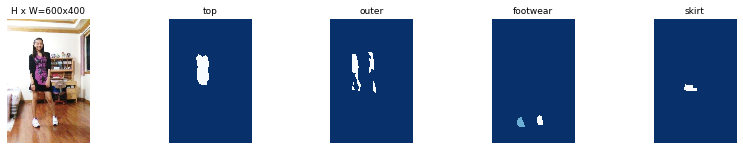

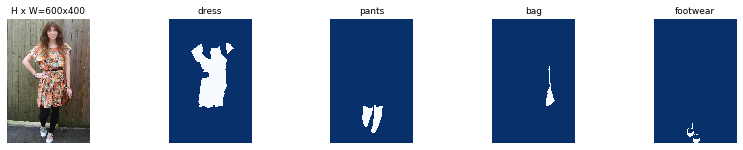

In [17]:
for i in range(2):
    image_id = random.choice(dataset.image_ids)
    print(dataset.image_reference(image_id))
    
    image = dataset.load_image(image_id)
    mask, class_ids = dataset.load_mask(image_id)
    
    visualize.display_top_masks(image, mask, class_ids, dataset.class_names, limit=4)


Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 26)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (6,)                  min:    2.00000  max:   10.00000  int32
gt_bbox                  shape: (6, 4)                min:  157.00000  max: 1023.00000  int32
gt_mask                  shape: (1024, 1024, 6)       min:    0.00000  max:    1.00000  bool
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 26)               min:    0.00000  max: 1024.00000  int64
anchors        

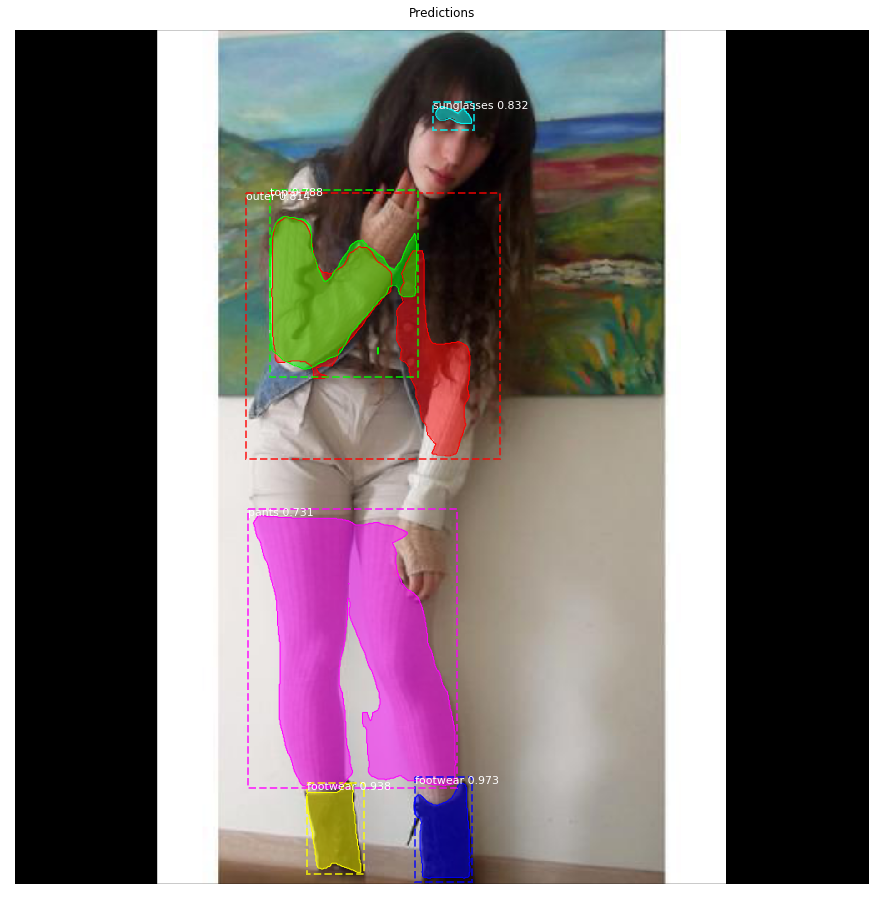

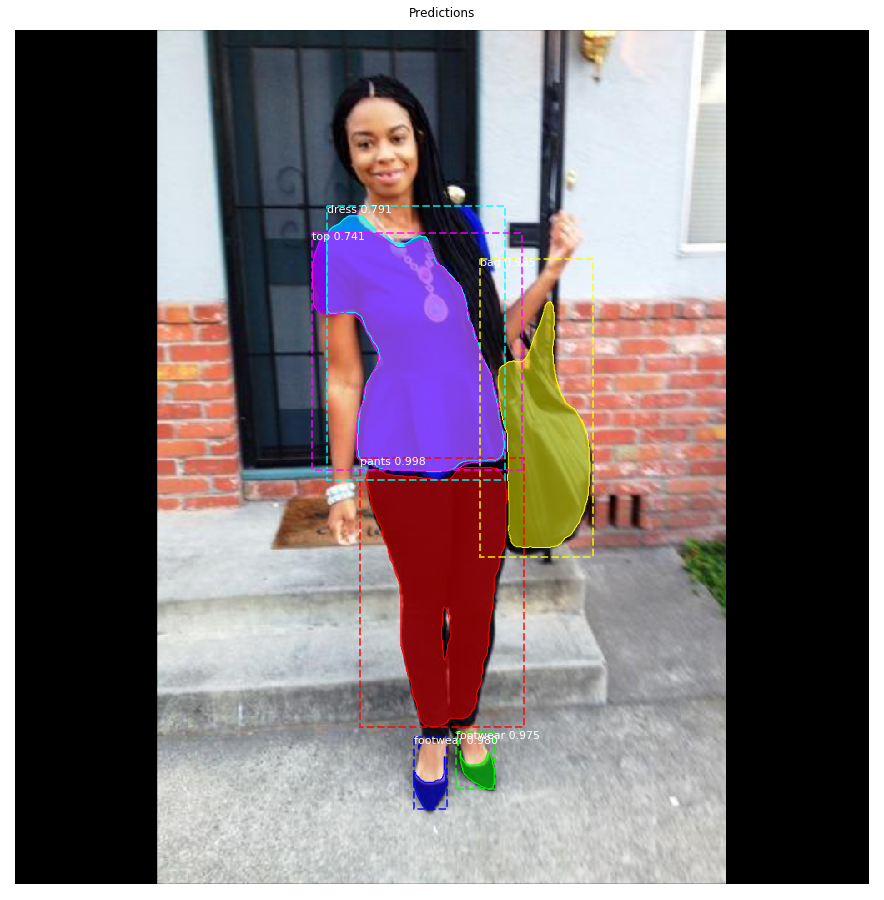

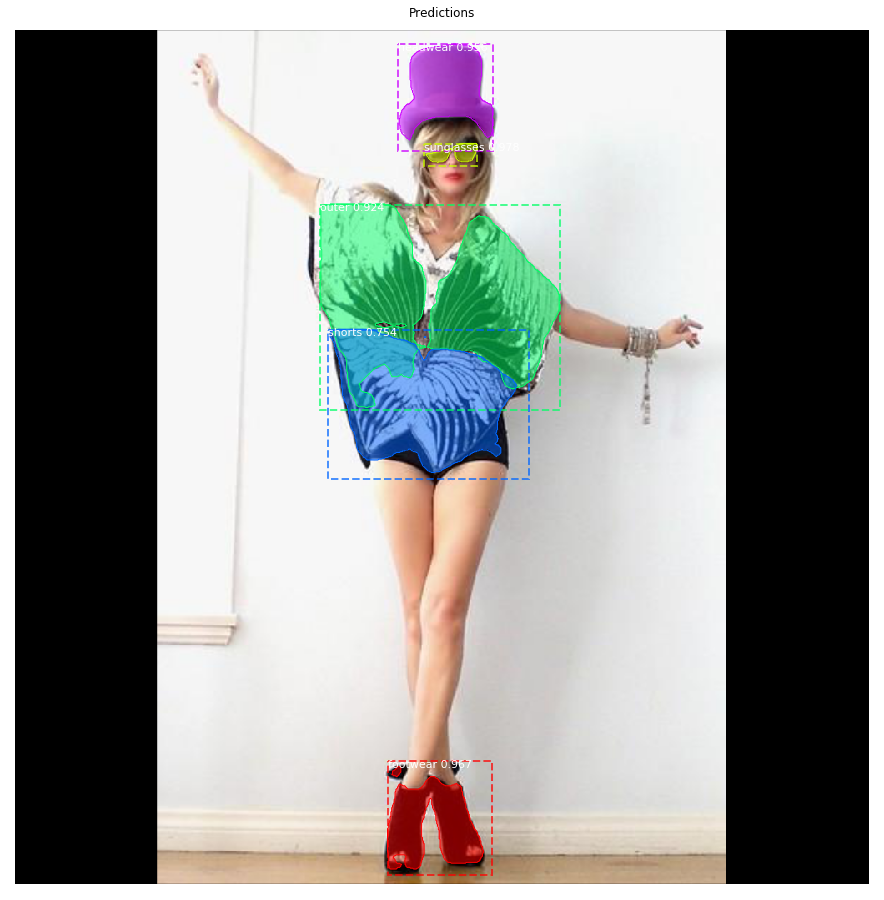

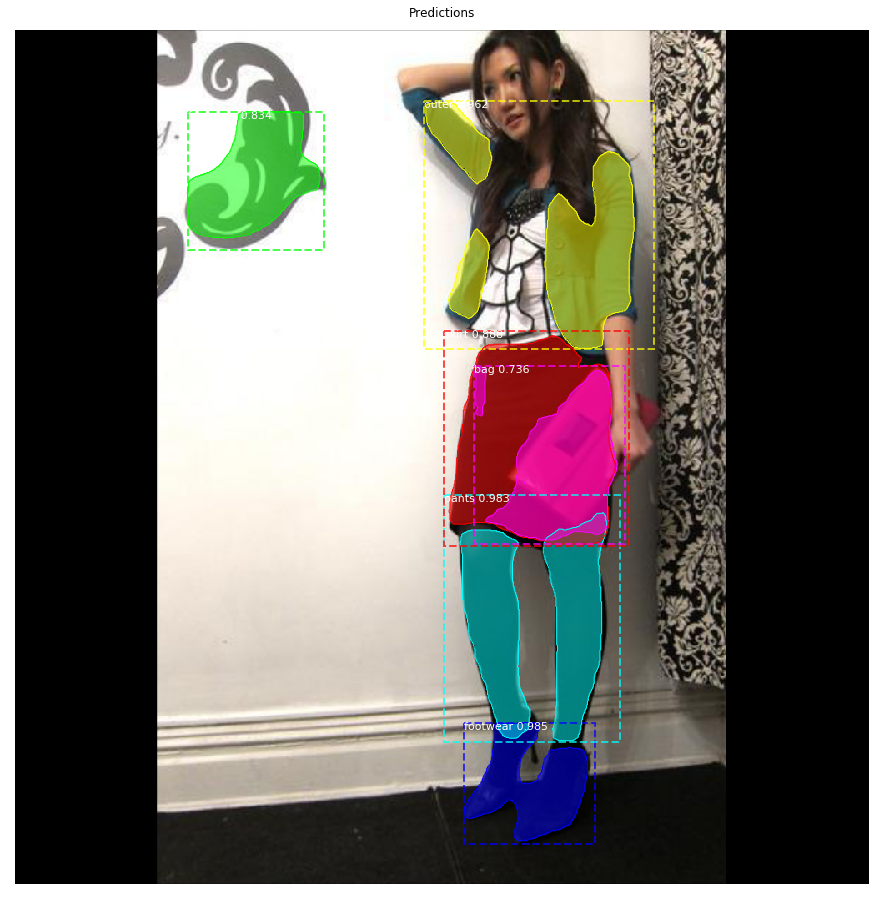

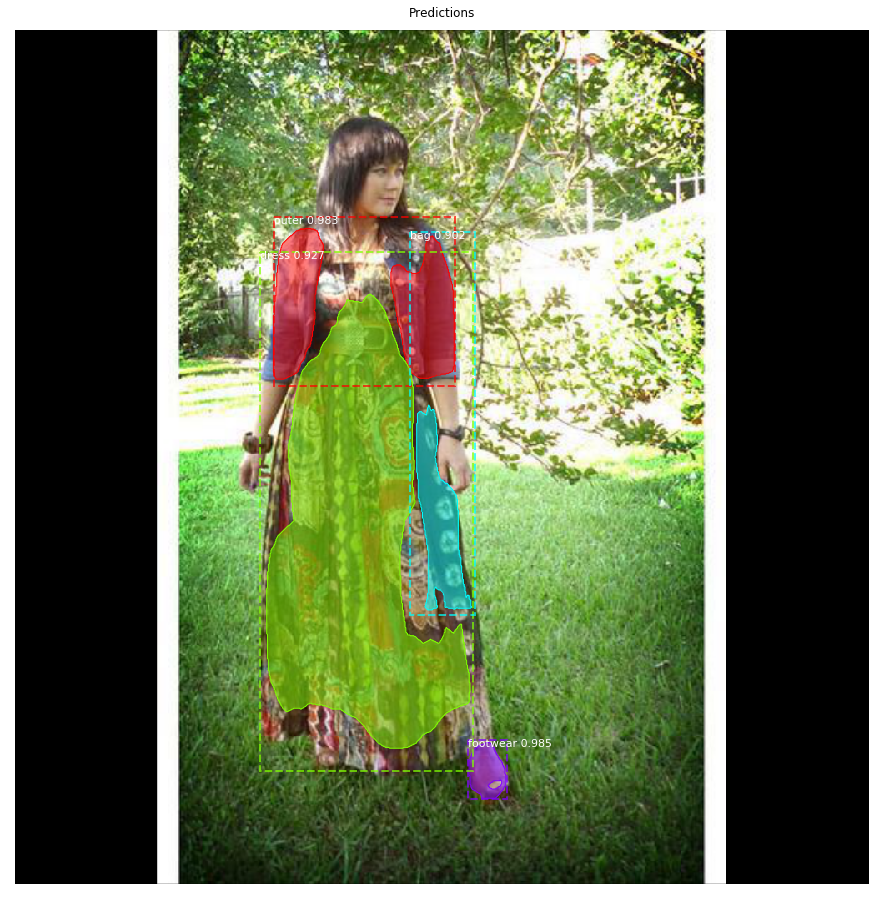

In [28]:
# HAVE A LOOK AT THE RESULT
for i in range(5):
    image_idx = random.choice(dataset.image_ids)
    info = dataset.image_info[image_idx]
    #print(info)
    image, image_meta, gt_class_id, gt_bbox, gt_mask = modellib.load_image_gt(dataset, infer_config, image_idx, use_mini_mask=False)
    
    #print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_idx, 
    #                                       dataset.image_reference(image_idx)))
    
    # Run object detection
    results = model_r.detect([image], verbose=1)
    ax = get_ax(1)
    r = results[0]

    visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'],
                            dataset.class_names, r['scores'], ax=ax,
                            title="Predictions")
    log("gt_class_id", gt_class_id)
    log("gt_bbox", gt_bbox)
    log("gt_mask", gt_mask)

0

*** No instances to display *** 


*** No instances to display *** 


*** No instances to display *** 


*** No instances to display *** 

10

*** No instances to display *** 

20


./mask_rcnn_lib/mrcnn/visualize.py:110: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(1, figsize=figsize)


30
40

*** No instances to display *** 

50

*** No instances to display *** 


*** No instances to display *** 

60
70
80

*** No instances to display *** 

90
100

*** No instances to display *** 


*** No instances to display *** 

110

*** No instances to display *** 

120
130

*** No instances to display *** 


*** No instances to display *** 

140
150

*** No instances to display *** 

160

*** No instances to display *** 

170
180

*** No instances to display *** 

190

*** No instances to display *** 


*** No instances to display *** 

200

*** No instances to display *** 

210
220
230

*** No instances to display *** 


*** No instances to display *** 

240
250
260

*** No instances to display *** 

270

*** No instances to display *** 

280

*** No instances to display *** 

290
300

*** No instances to display *** 

310

*** No instances to display *** 

320

*** No instances to display *** 

330

*** No instances to display *** 


*** No instances to display *** 

340

***

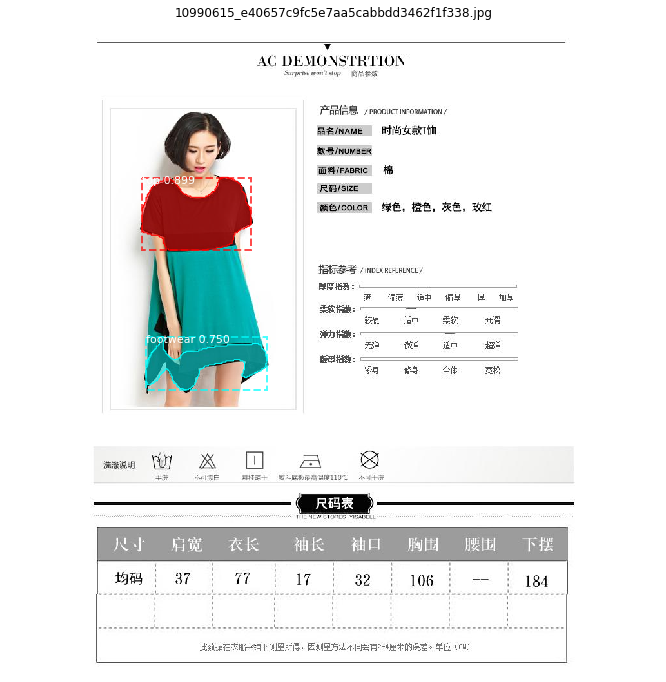

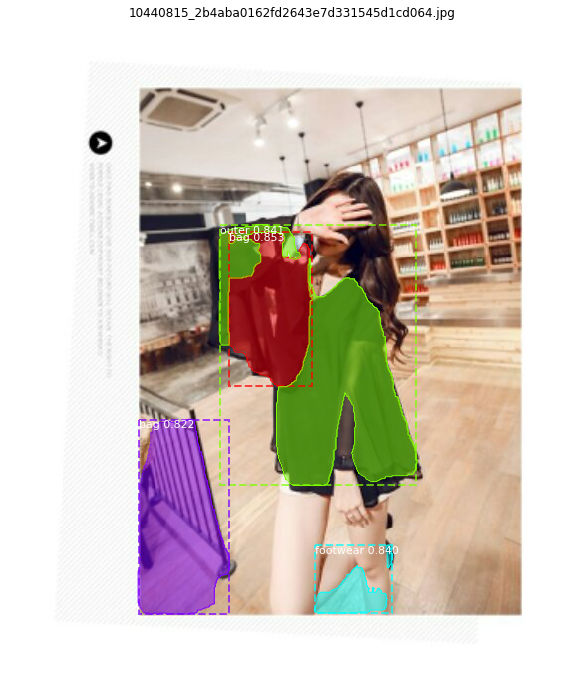

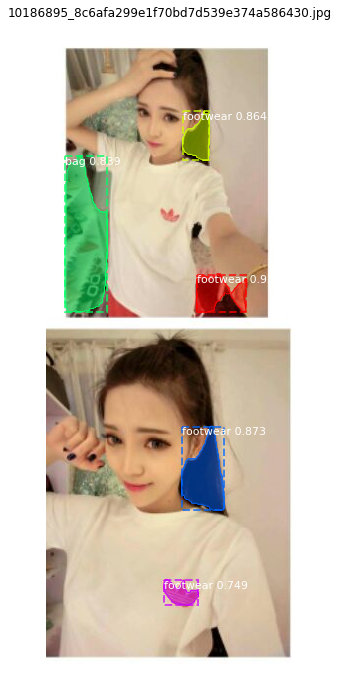

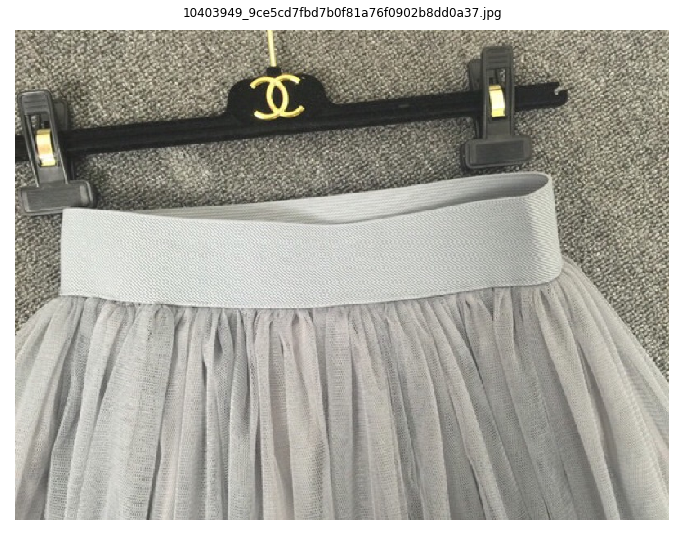

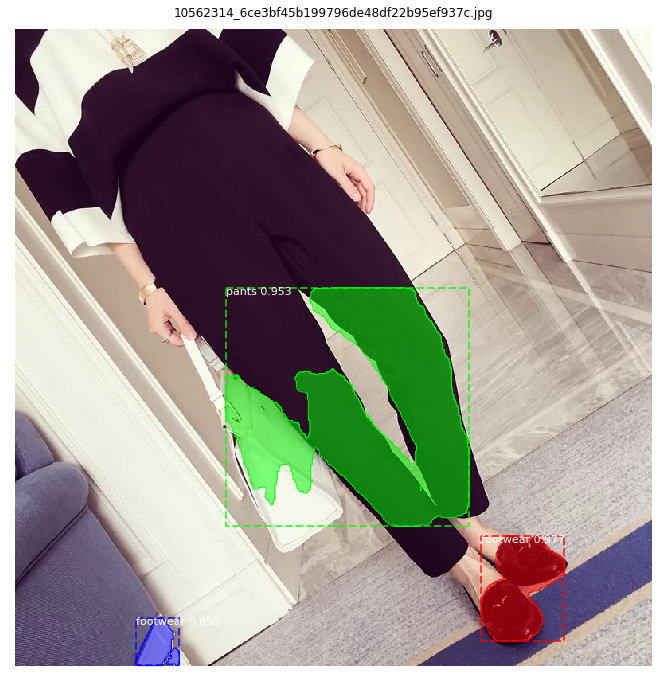

...

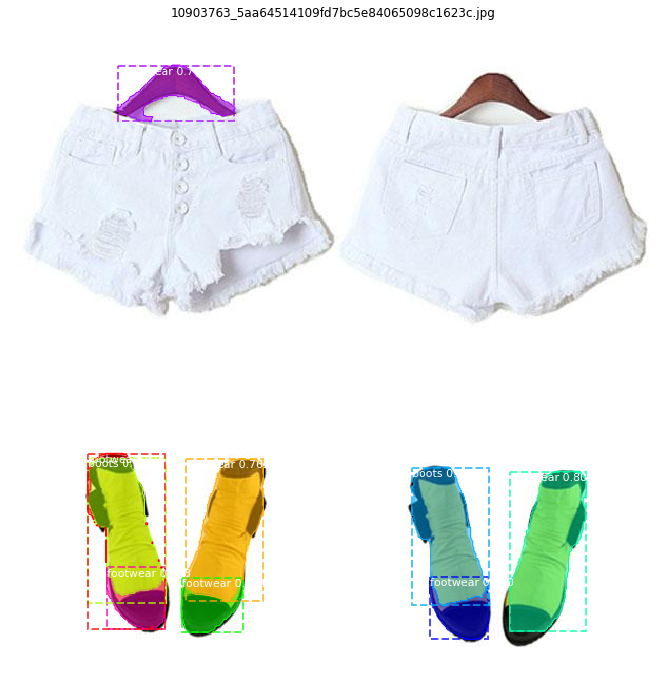

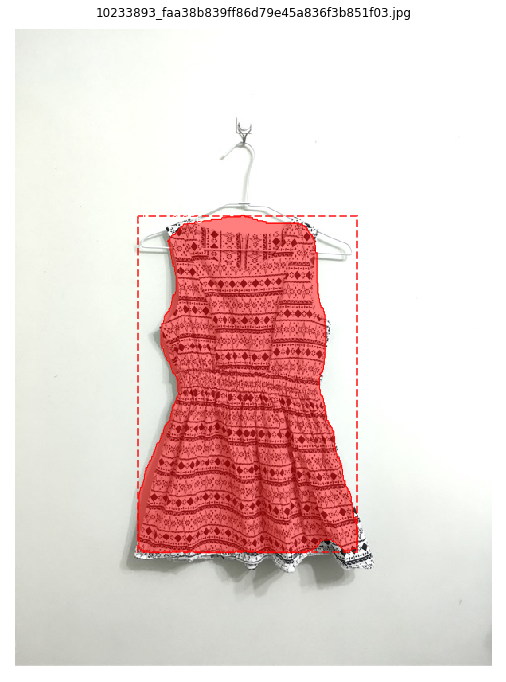

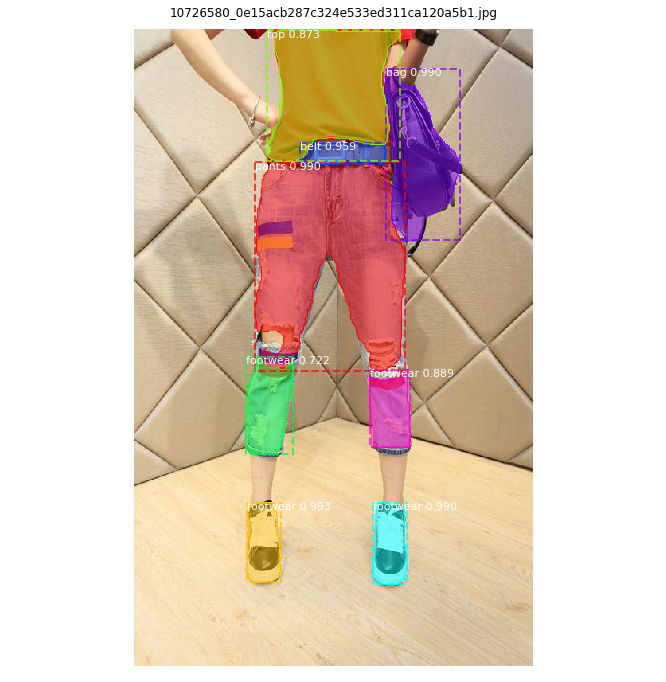

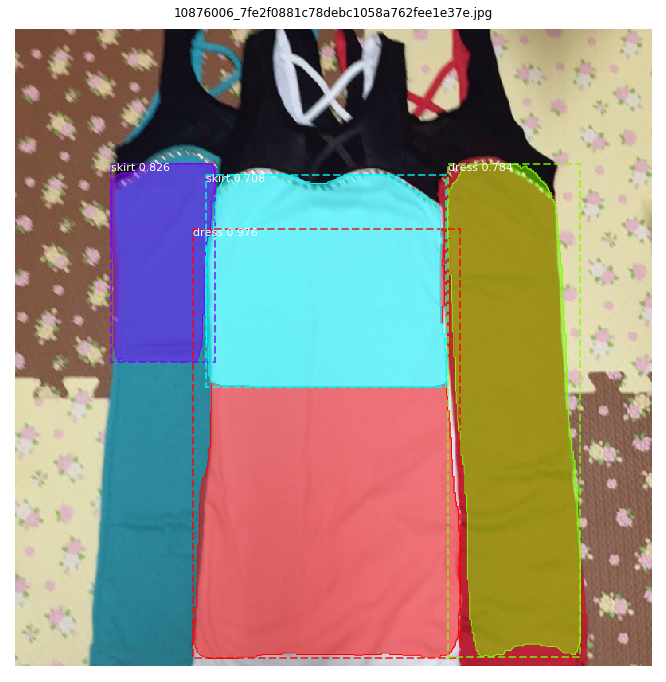

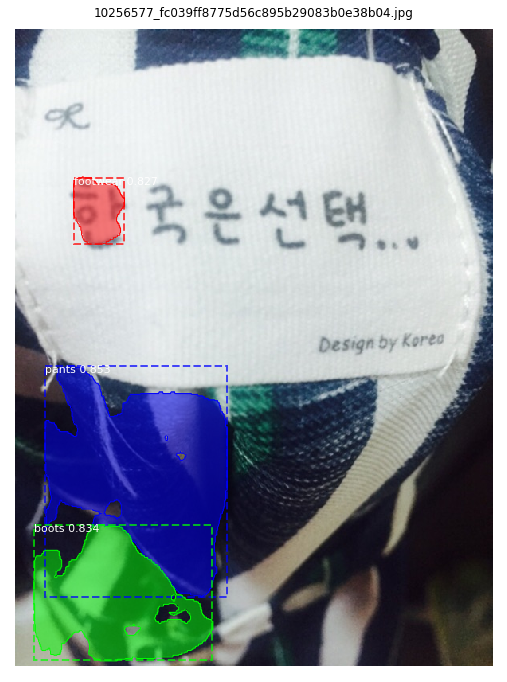

In [ ]:
# does not permit overlapped masks, we have to fix them
def refine_masks(masks, rois):
    areas = np.sum(masks.reshape(-1, masks.shape[-1]), axis=0)
    mask_index = np.argsort(areas)
    union_mask = np.zeros(masks.shape[:-1], dtype=bool)
    for m in mask_index:
        masks[:, :, m] = np.logical_and(masks[:, :, m], np.logical_not(union_mask))
        union_mask = np.logical_or(masks[:, :, m], union_mask)
    for m in range(masks.shape[-1]):
        mask_pos = np.where(masks[:, :, m]==True)
        if np.any(mask_pos):
            y1, x1 = np.min(mask_pos, axis=1)
            y2, x2 = np.max(mask_pos, axis=1)
            rois[m, :] = [y1, x1, y2, x2]
    return masks, rois

def resize_image(image_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (IMAGE_SIZE, IMAGE_SIZE), interpolation=cv2.INTER_AREA)  
    return img

sample_path = "/root/workspace/product_image_segmentation/data/shopee/sample/"
shopee_out = "/root/workspace/product_image_segmentation/data/shopee/out27/"
counter = 0 
for one in os.listdir(sample_path):
    if counter > 1000 :
        break
    if counter %10 == 0:
        print(counter)
        
    counter += 1
    image_path = str(sample_path + one)
    
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    result = model_r.detect([resize_image(image_path)])
    r = result[0]
    
    if r['masks'].size > 0:
        masks = np.zeros((img.shape[0], img.shape[1], r['masks'].shape[-1]), dtype=np.uint8)
        for m in range(r['masks'].shape[-1]):
            masks[:, :, m] = cv2.resize(r['masks'][:, :, m].astype('uint8'), 
                                        (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)
        
        y_scale = img.shape[0]/IMAGE_SIZE
        x_scale = img.shape[1]/IMAGE_SIZE
        rois = (r['rois'] * [y_scale, x_scale, y_scale, x_scale]).astype(int)
        
        masks, rois = refine_masks(masks, rois)
    else:
        masks, rois = r['masks'], r['rois']
        
    #print(len(r['class_ids']), "===>", r['class_ids'])
    
    visualize.display_instances(img, rois, masks, r['class_ids'], 
                                ['bg']+label_names, r['scores'],
                                title=one, figsize=(12, 12),save_path=shopee_out+one, 
                                disp_img=False)

23538
image ID: fashion.0 (23538) 
{'id': 0, 'source': 'fashion', 'path': '/root/workspace/product_image_segmentation/data/paperdoll/images/photos/Apple9/4802776836/1598948556/beige-franco-sarto-shoes-blue-thrifted-socks-gray-forever21-shorts-green-t_400.jpg', 'labels': [9, 5, 2, 10, 4, 4], 'polygons': [[219, 206, 173, 209, 157, 213, 153, 208, 154, 203, 160, 191, 159, 184, 161, 168, 158, 148, 154, 118, 155, 114, 158, 113, 175, 111, 197, 122, 218, 122, 221, 119, 243, 143, 258, 159, 245, 203, 229, 205], [155, 219, 152, 281, 153, 300, 151, 302, 149, 298, 145, 278, 141, 265, 134, 257, 129, 256, 126, 286, 124, 281, 125, 224, 132, 157, 143, 121, 150, 114, 157, 111, 166, 111, 186, 108, 186, 110, 177, 113, 176, 112, 156, 114, 155, 119, 161, 167, 159, 183, 160, 191, 152, 209, 157, 213], [309, 79, 305, 123, 290, 178, 289, 190, 277, 194, 246, 200, 258, 158, 239, 139, 217, 115, 219, 108, 229, 111, 239, 111, 243, 105, 245, 104, 252, 104, 257, 100, 260, 100, 263, 94, 267, 79, 285, 68, 298, 65, 308, 

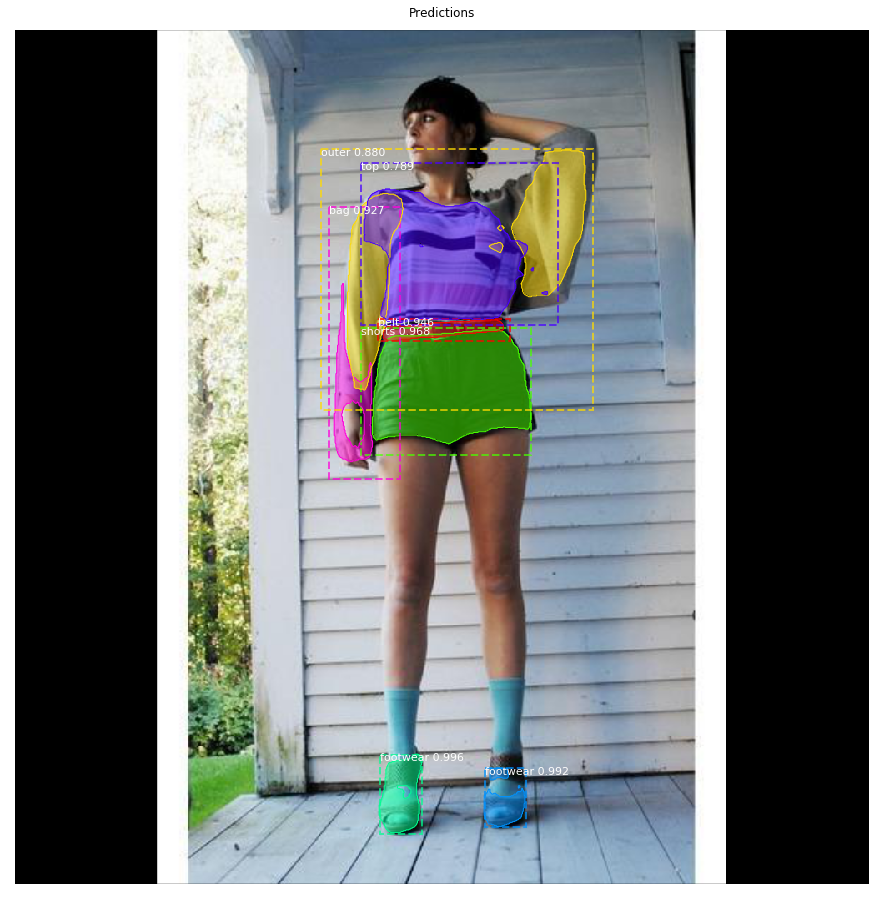

In [38]:
image_idx = random.choice(dataset.image_ids)
print(image_idx)
image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(dataset, config, image_idx, use_mini_mask=False)
info = dataset.image_info[image_idx]
print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_idx, 
                                       dataset.image_reference(image_idx)))
print(info)
# Run object detection
results = model_r.detect([image], verbose=1)
#print(results)
# Display results
ax = get_ax(1)
r = results[0]
visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                            dataset.class_names, r['scores'], ax=ax,
                            title="Predictions")
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

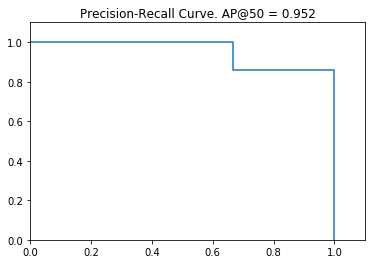

In [39]:
# Draw precision-recall curve
AP, precisions, recalls, overlaps = utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                                          r['rois'], r['class_ids'], r['scores'], r['masks'])
visualize.plot_precision_recall(AP, precisions, recalls)

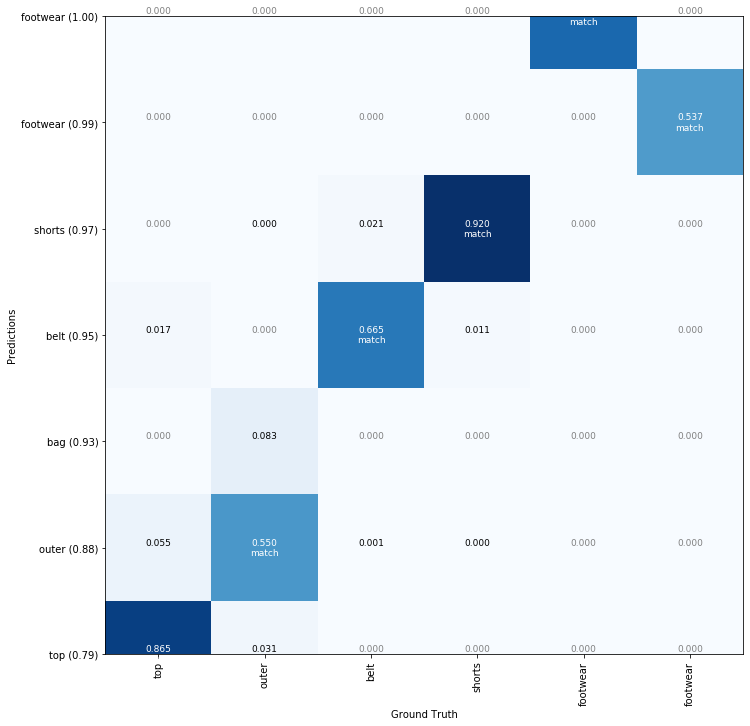

In [40]:
# Grid of ground truth objects and their predictions
visualize.plot_overlaps(gt_class_id, r['class_ids'], r['scores'], overlaps, dataset.class_names)

In [45]:
# Compute VOC-style Average Precision
def compute_batch_ap(image_ids):
    APs = []
    for image_id in image_ids:
        # Load image
        image, image_meta, gt_class_id, gt_bbox, gt_mask =\
            modellib.load_image_gt(dataset, config,
                                   image_id, use_mini_mask=False)
        # Run object detection
        results = model_r.detect([image], verbose=0)
        # Compute AP
        r = results[0]
        AP, precisions, recalls, overlaps =\
            utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                              r['rois'], r['class_ids'], r['scores'], r['masks'])
        APs.append(AP)
    return APs

# Pick a set of random images
image_ids = np.random.choice(dataset.image_ids, 1000)
APs = compute_batch_ap(image_ids)
print("mAP @ IoU=50: ", np.mean(APs))

mAP @ IoU=50:  0.4993029372193688


In [ ]:
mAP @ IoU=50:  0.5349801626375743  mAP @ IoU=50:  0.49391052133885643

In [ ]:
import time
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
from pycocotools import mask as maskUtils

 
# Import Mask RCNN
sys.path.append("./mask_rcnn_lib")  # To find local version of the library
from mrcnn.config import Config
from mrcnn import model as modellib, utils
from pycocotools import mask as maskUtils
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log
from tensorflow.contrib.tensorboard.plugins import projector


############################################################
#  COCO Evaluation
############################################################

def build_coco_results(dataset, image_ids, rois, class_ids, scores, masks):
    """Arrange resutls to match COCO specs in http://cocodataset.org/#format
    """
    # If no results, return an empty list
    if rois is None:
        return []

    results = []
    for image_id in image_ids:
        # Loop through detections
        for i in range(rois.shape[0]):
            class_id = class_ids[i]
            score = scores[i]
            bbox = np.around(rois[i], 1)
            mask = masks[:, :, i]

            result = {
                "image_id": image_id,
                "category_id": dataset.get_source_class_id(class_id, "coco"),
                "bbox": [bbox[1], bbox[0], bbox[3] - bbox[1], bbox[2] - bbox[0]],
                "score": score,
                "segmentation": maskUtils.encode(np.asfortranarray(mask))
            }
            results.append(result)
    return results


def evaluate_coco(model, dataset, coco, eval_type=None, limit=0, image_ids=None):
    """Runs official COCO evaluation.
    dataset: A Dataset object with valiadtion data
    eval_type: "bbox" or "segm" for bounding box or segmentation evaluation
    limit: if not 0, it's the number of images to use for evaluation
    """
    # Pick COCO images from the dataset
    image_ids = image_ids or dataset.image_ids

    # Limit to a subset
    if limit:
        image_ids = image_ids[:limit]

    # Get corresponding COCO image IDs.
    coco_image_ids = [dataset.image_info[id]["id"] for id in image_ids]

    t_prediction = 0
    t_start = time.time()

    results = []
    for i, image_id in enumerate(image_ids):
        # Load image
        image = dataset.load_image(image_id)

        # Run detection
        t = time.time()
        r = model.detect([image], verbose=0)[0]
        t_prediction += (time.time() - t)

        # Convert results to COCO format
        # Cast masks to uint8 because COCO tools errors out on bool
        image_results = build_coco_results(dataset, coco_image_ids[i:i + 1],
                                           r["rois"], r["class_ids"],
                                           r["scores"],
                                           r["masks"].astype(np.uint8))
        results.extend(image_results)

    # Load results. This modifies results with additional attributes.
    coco_results = coco.loadRes(results)

    # Evaluate
    if None != eval_type:
        cocoEval = COCOeval(coco, coco_results, eval_type)
        cocoEval.params.imgIds = coco_image_ids
        cocoEval.evaluate()
        cocoEval.accumulate()
        cocoEval.summarize()

        print("Prediction time: {}. Average {}/image".format(
            t_prediction, t_prediction / len(image_ids)))
        print("Total time: ", time.time() - t_start)

    else:
        bboxEval = COCOeval(coco, coco_results, "bbox")
        bboxEval.params.imgIds = coco_image_ids
        bboxEval.evaluate()
        bboxEval.accumulate()
        bboxEval.summarize()

        print(" bbox EvalPrediction time: {}. Average {}/image".format(
            t_prediction, t_prediction / len(image_ids)))
        print("Total time: ", time.time() - t_start)

        segmEval = COCOeval(coco, coco_results, "segm")
        segmEval.params.imgIds = coco_image_ids
        segmEval.evaluate()
        segmEval.accumulate()
        segmEval.summarize()

        print(" segm EvalPrediction time: {}. Average {}/image".format(
            t_prediction, t_prediction / len(image_ids)))
        print("Total time: ", time.time() - t_start)
        

def evaluate_model(model_weights_path, eval_type=None, limit=0, image_ids=None, log_dir="."):
    ####### prepare Photo Meta Data

    access_str = "file:" + PAPERDOLL_META_DB + "?mode=ro"
    meta_db = sqlite3.connect(access_str, uri=True)
    photo_meta_db = pd.read_sql("""
                SELECT
                    *
                FROM photos
                WHERE photos.post_id IS NOT NULL AND file_file_size IS NOT NULL
            """, con=meta_db)

    ####### prepare Annotation Data
    coco = COCO(MODANET_ANNO)

    cats = coco.loadCats(coco.getCatIds())
    label_names = [cat['name'] for cat in cats]
    cat_ids = coco.getCatIds(catNms = label_names)

    anno_img_id_set = []
    for i in range(len(cat_ids)):
        anno_img_id_set.extend(coco.getImgIds(catIds=[i]))
    print("total annotation number: ", len(anno_img_id_set))

    # drop  images meta entries that without annotation
    anno_img_id_pd = pd.DataFrame({'id':anno_img_id_set})
    anno_img_id_pd['id'] =anno_img_id_pd['id'].apply(int)
    photo_meta_db = pd.merge(photo_meta_db, anno_img_id_pd, how='inner', on=['id'])
    # drop duplicate
    photo_meta_db = photo_meta_db.drop_duplicates()
    print("photo_meta_db size: ", len(photo_meta_db))

    dataset = ModaNetDataset(photo_meta_db, coco, label_names, cat_ids)
    dataset.load_all_dataset()
    dataset.prepare()

    ##### prepare model
    infer_config = InferenceConfig()
    model = modellib.MaskRCNN(mode='inference', 
                          config=infer_config,
                          model_dir=log_dir)
    
 
    assert model_weights_path != '', "Provide path to load trained weights"
    print("Loading weights from ", model_weights_path)
    model.load_weights(model_weights_path, by_name=True)

    evaluate_coco(model, dataset, coco, eval_type, limit, image_ids)
    

In [ ]:
evaluate_coco(model_r, dataset, coco, eval_type=None, limit=10, image_ids=None)
